In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import os
import zipfile
import pandas as pd
import numpy as np
import librosa
import librosa.display
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import classification_report, confusion_matrix
import seaborn as sns

In [ ]:
def extract_features(file_path, zip_file):
    with zip_file.open(file_path) as file:
        y, sr = librosa.load(file, sr=None)
        S = librosa.feature.melspectrogram(y=y, sr=sr, n_mels=128)
        S_DB = librosa.power_to_db(S, ref=np.max)
        return S_DB, sr

In [ ]:
def plot_mel_spectrogram(S_DB, sr, title):
    plt.figure(figsize=(10, 4))
    librosa.display.specshow(S_DB, sr=sr, x_axis='time', y_axis='mel')
    plt.colorbar(format='%+2.0f dB')
    plt.title(title)
    plt.show()

In [ ]:
zip_path = '/content/drive/MyDrive/Bird sound classification data/archive (1).zip'
metadata_path = '/content/drive/MyDrive/Bird sound classification data/bird_songs_metadata.csv'
metadata = pd.read_csv(metadata_path)


feature_list_mel = []
labels = []
file_paths = []

with zipfile.ZipFile(zip_path, 'r') as z:
    for index, row in metadata.iterrows():
        file_path = os.path.join('wavfiles', row['filename'])
        if file_path in z.namelist():
            S_DB,sr= extract_features(file_path, z)
            feature_list_mel.append(np.mean(S_DB, axis=1))
            labels.append(row['species'])
            file_paths.append(file_path)

In [ ]:

X_train_mel, X_test_mel, y_train, y_test, files_train, files_test = train_test_split(feature_list_mel, labels, file_paths, test_size=0.2, random_state=42)
scaler_mel = StandardScaler()
X_train_mel_scaled = scaler_mel.fit_transform(X_train_mel)
X_test_mel_scaled = scaler_mel.transform(X_test_mel)


label_encoder = LabelEncoder()
y_train_encoded = label_encoder.fit_transform(y_train)
y_test_encoded = label_encoder.transform(y_test)
knn = KNeighborsClassifier(n_neighbors=5)
knn.fit(X_train_mel_scaled, y_train_encoded)
y_prob = knn.predict_proba(X_test_mel_scaled)

In [ ]:
highest_prob_indices = np.argsort(-np.max(y_prob, axis=1))[:10]
print(highest_prob_indices)

[  0 399 400 809 808 403 405 398 806 408]


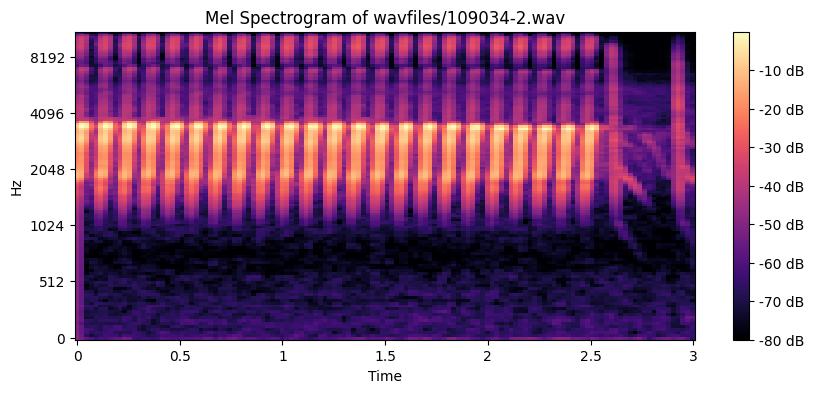

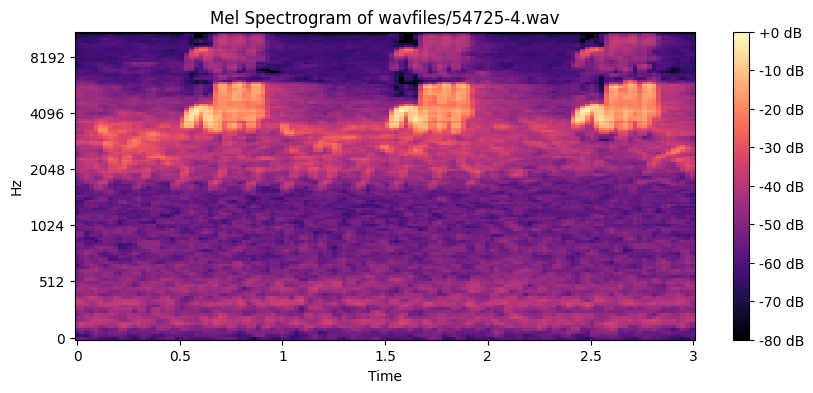

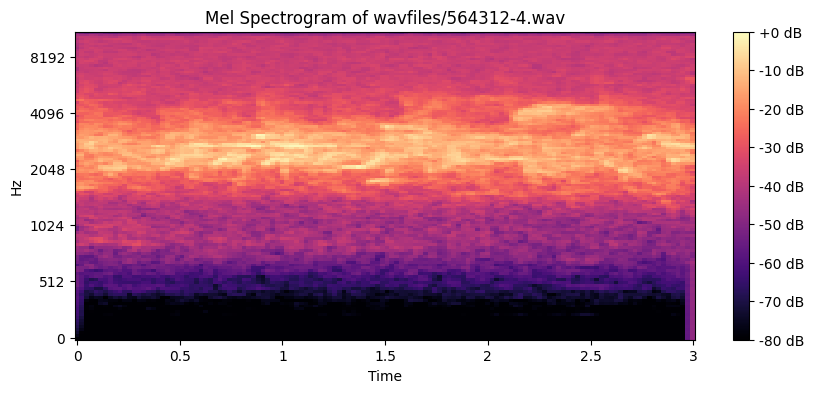

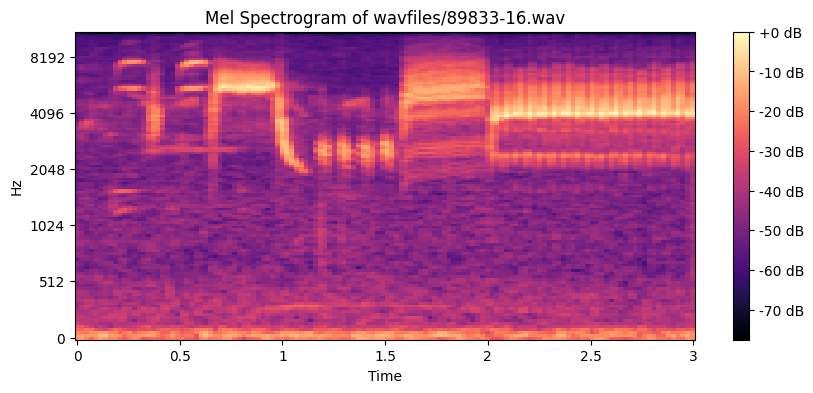

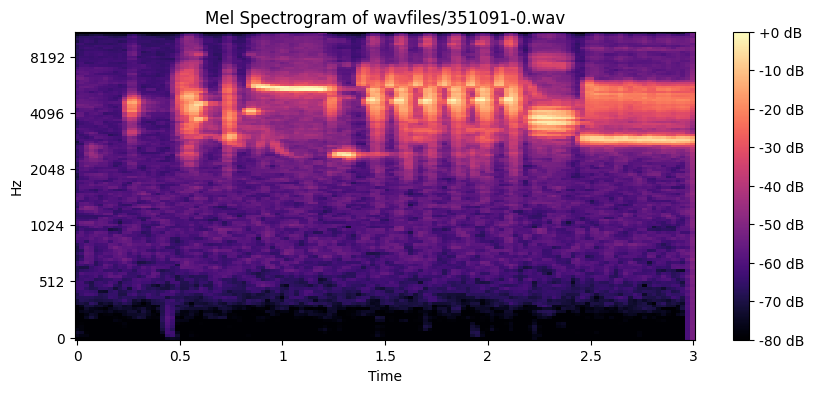

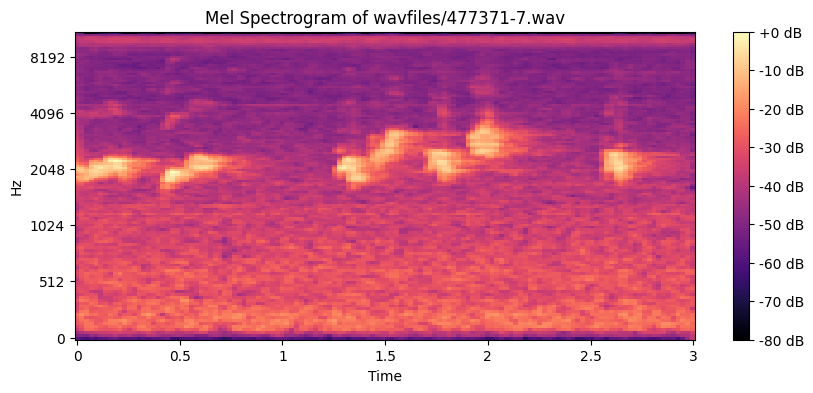

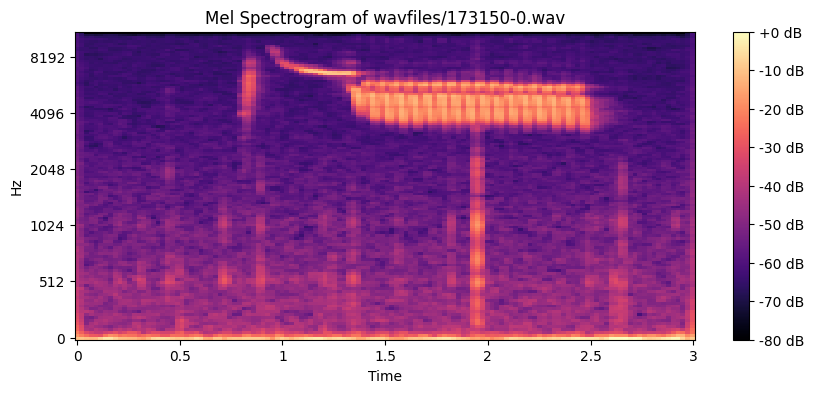

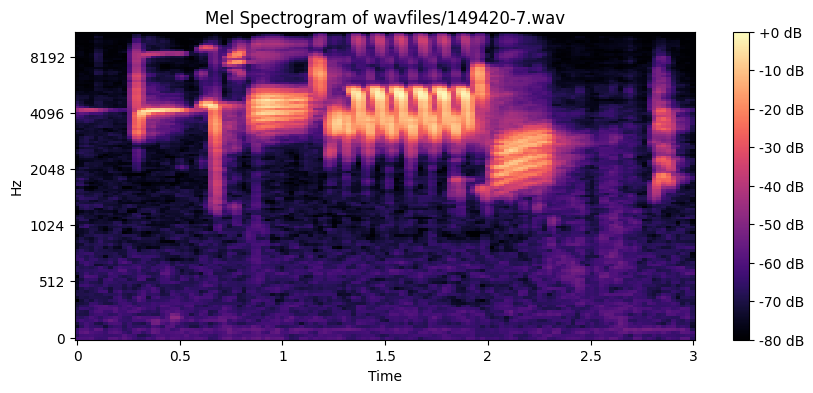

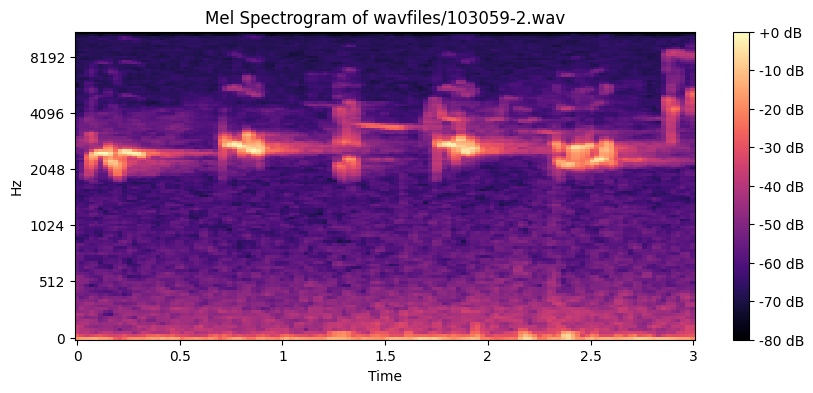

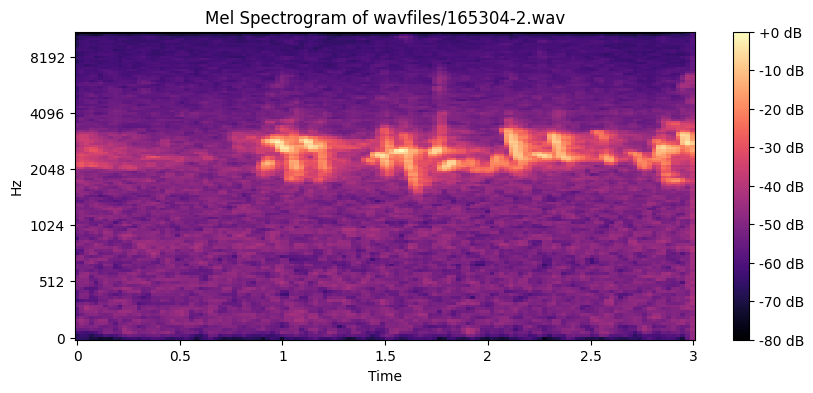

In [ ]:
with zipfile.ZipFile(zip_path, 'r') as z:
    for index in highest_prob_indices:
        file_path = files_test[index]
        S_DB, sr = extract_features(file_path, z)
        plot_mel_spectrogram(S_DB, sr, f"Mel Spectrogram of {file_path}")

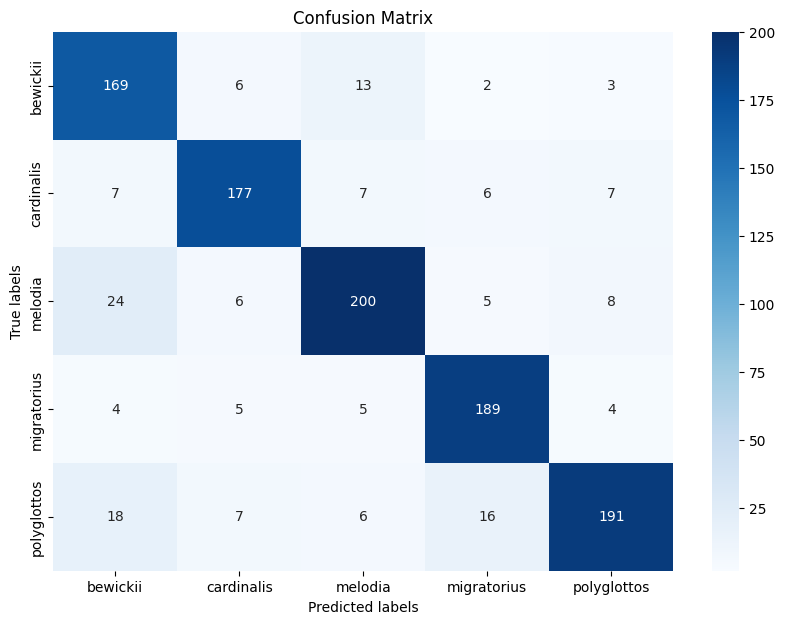

              precision    recall  f1-score   support

           0       0.76      0.88      0.81       193
           1       0.88      0.87      0.87       204
           2       0.87      0.82      0.84       243
           3       0.87      0.91      0.89       207
           4       0.90      0.80      0.85       238

    accuracy                           0.85      1085
   macro avg       0.85      0.86      0.85      1085
weighted avg       0.86      0.85      0.85      1085



In [ ]:
y_pred_encoded = knn.predict(X_test_mel_scaled)
cm = confusion_matrix(y_test_encoded, y_pred_encoded)
plt.figure(figsize=(10, 7))
sns.heatmap(cm, annot=True, fmt='g', cmap='Blues', xticklabels=label_encoder.classes_, yticklabels=label_encoder.classes_)
plt.xlabel('Predicted labels')
plt.ylabel('True labels')
plt.title('Confusion Matrix')
plt.show()
print(classification_report(y_test_encoded, y_pred_encoded))

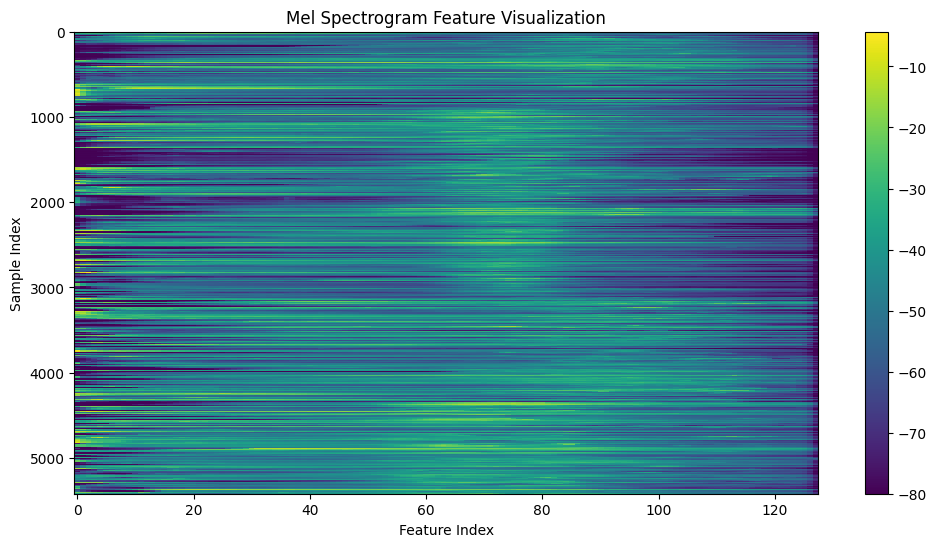

In [ ]:
features_2D_mel = np.vstack(feature_list_mel)
plt.figure(figsize=(12, 6))
plt.imshow(features_2D_mel, aspect='auto', interpolation='nearest', cmap='viridis')
plt.colorbar()
plt.title('Mel Spectrogram Feature Visualization')
plt.xlabel('Feature Index')
plt.ylabel('Sample Index')
plt.show()

In [ ]:
lowest_prob_indices = np.argsort(np.max(y_prob, axis=1))[:10]
print(lowest_prob_indices)

[446 495 889 404 881 866 860 406 837 513]


In [ ]:
incorrect_indices = [i for i, (pred, actual) in enumerate(zip(y_pred_encoded, y_test_encoded)) if pred != actual]
print(incorrect_indices)

[11, 17, 29, 30, 37, 43, 48, 58, 69, 74, 78, 80, 82, 88, 93, 95, 101, 102, 106, 119, 122, 136, 141, 143, 166, 173, 174, 180, 188, 192, 206, 277, 289, 291, 299, 321, 324, 330, 333, 346, 347, 364, 366, 388, 404, 406, 410, 411, 413, 418, 445, 459, 469, 473, 474, 481, 486, 489, 513, 517, 524, 529, 536, 537, 552, 555, 558, 565, 570, 572, 574, 576, 579, 584, 585, 586, 587, 602, 604, 606, 621, 622, 634, 636, 650, 655, 657, 658, 659, 670, 674, 680, 686, 689, 697, 698, 705, 708, 710, 712, 715, 716, 719, 729, 747, 754, 757, 762, 769, 774, 795, 796, 804, 805, 807, 817, 860, 862, 865, 866, 887, 889, 890, 895, 897, 911, 914, 923, 927, 931, 933, 936, 942, 944, 945, 946, 948, 959, 962, 969, 970, 977, 982, 984, 997, 1018, 1022, 1033, 1038, 1045, 1047, 1049, 1060, 1065, 1066, 1068, 1069, 1076, 1079]


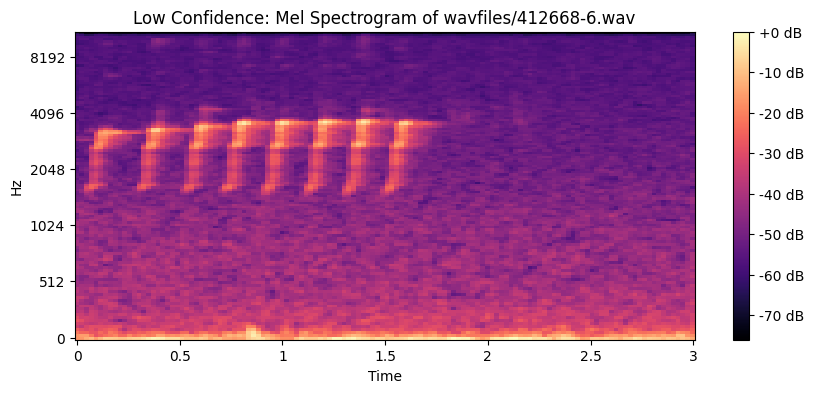

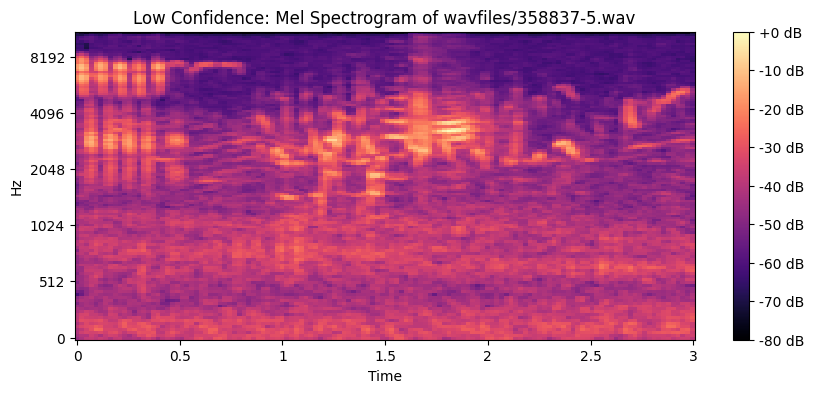

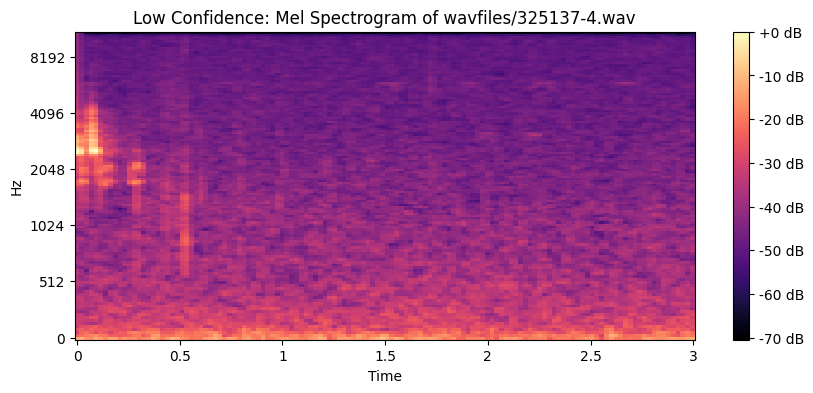

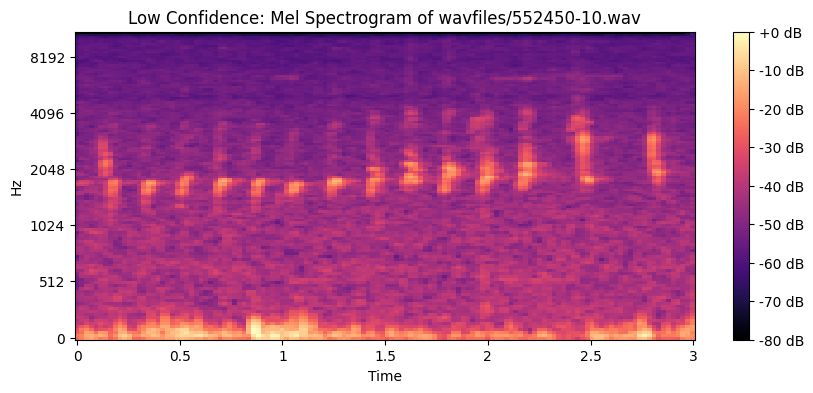

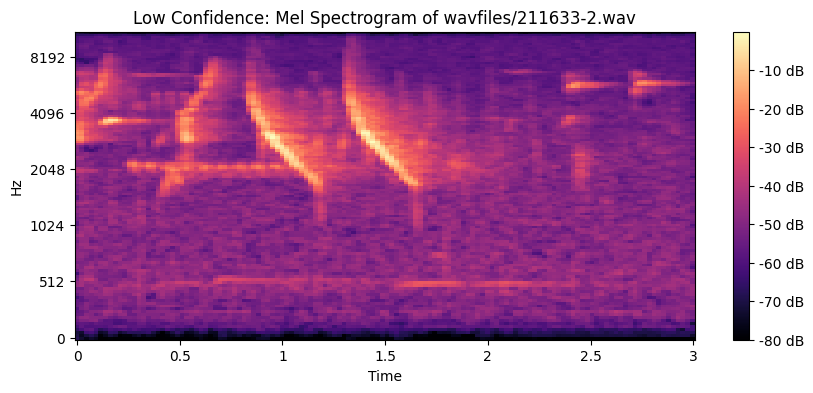

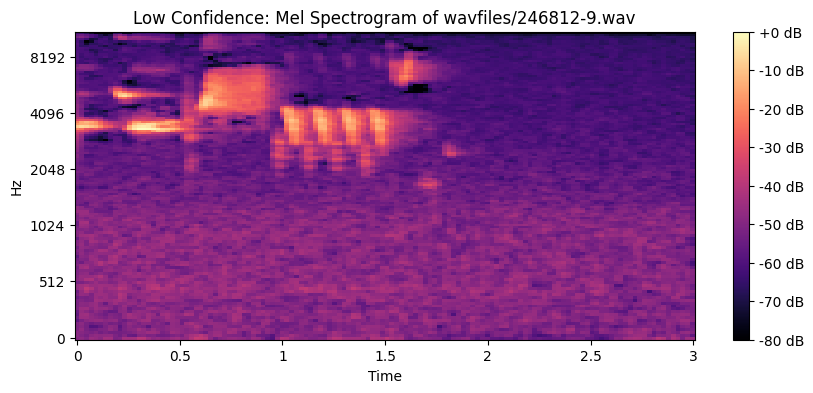

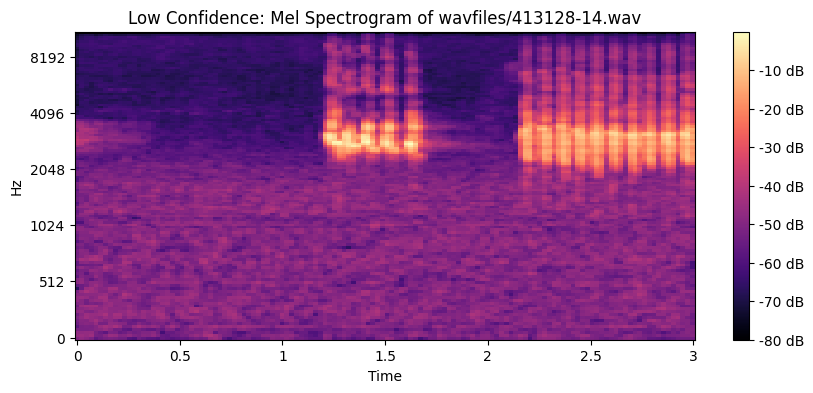

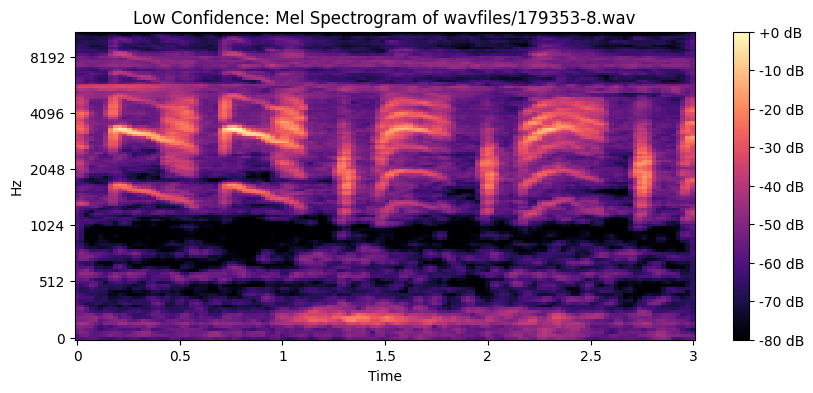

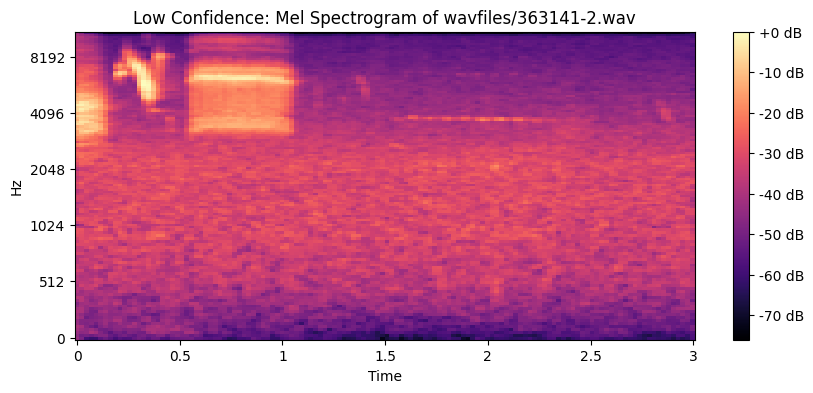

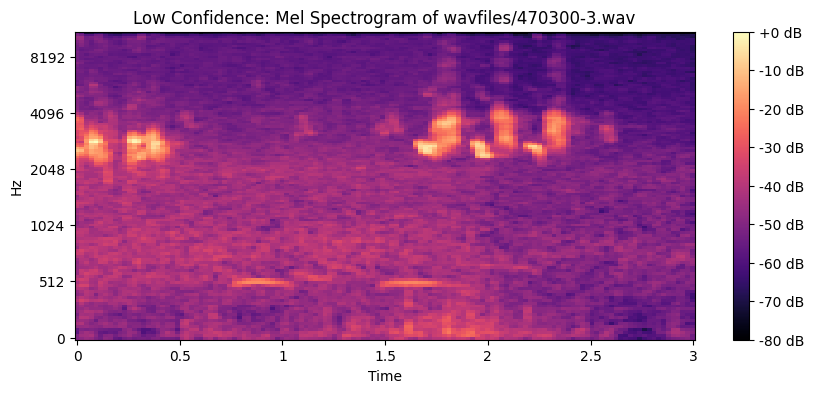

In [ ]:
with zipfile.ZipFile(zip_path, 'r') as z:
    for index in lowest_prob_indices:
        file_path = files_test[index]
        S_DB, sr = extract_features(file_path, z)
        plot_mel_spectrogram(S_DB, sr, f"Low Confidence: Mel Spectrogram of {file_path}")

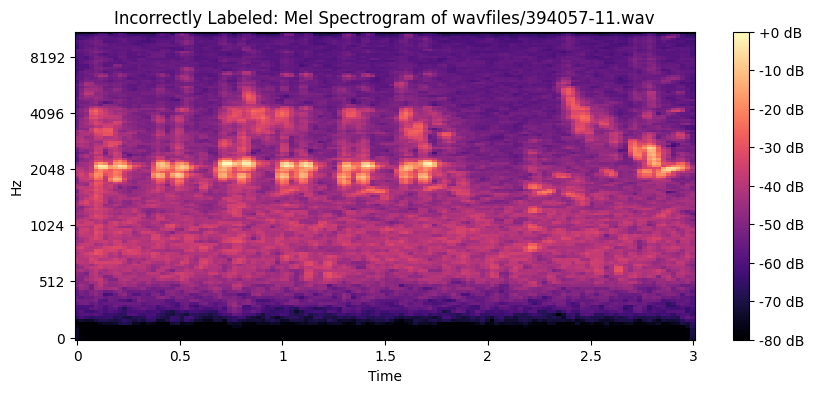

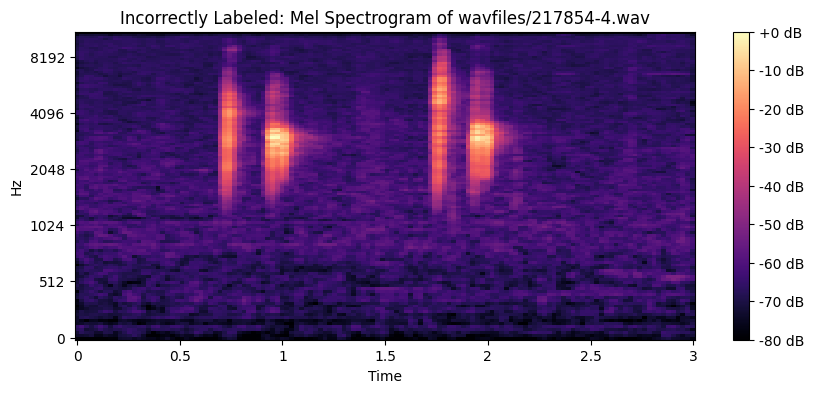

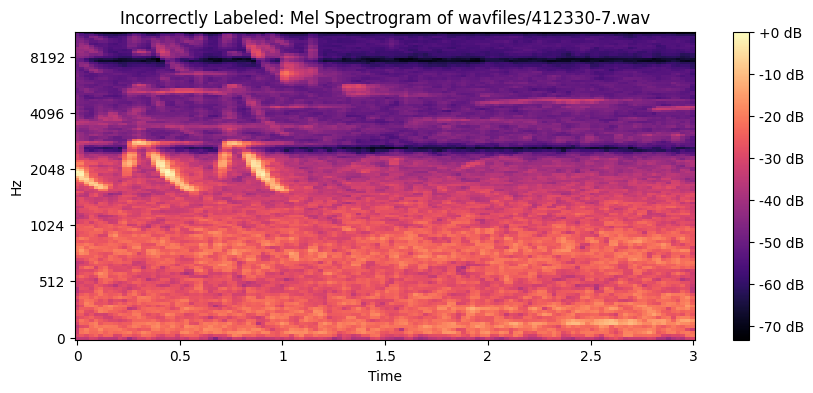

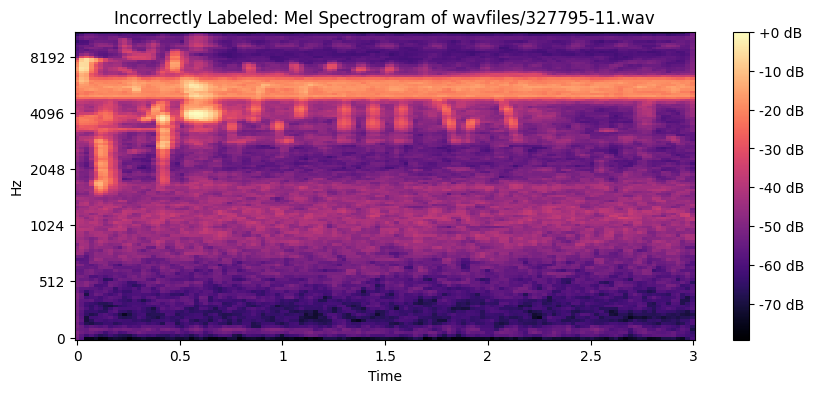

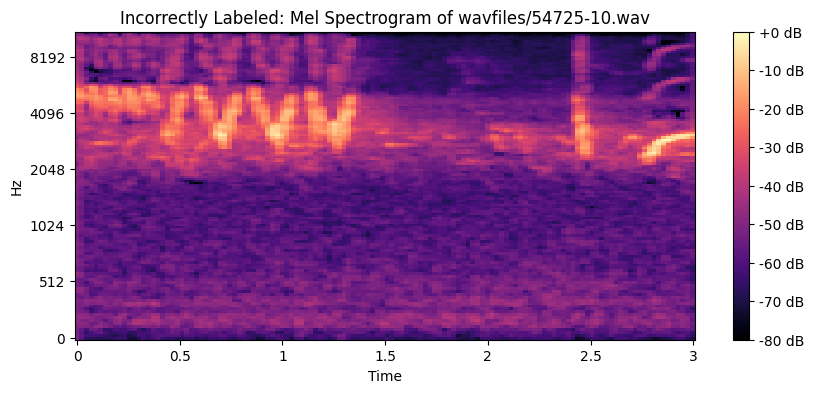

...

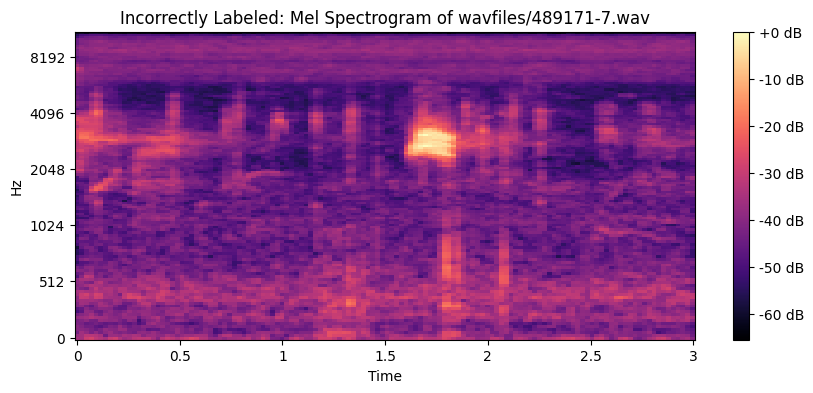

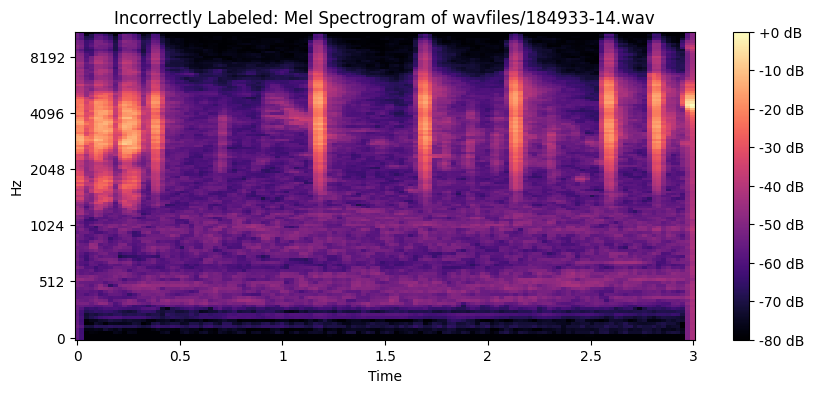

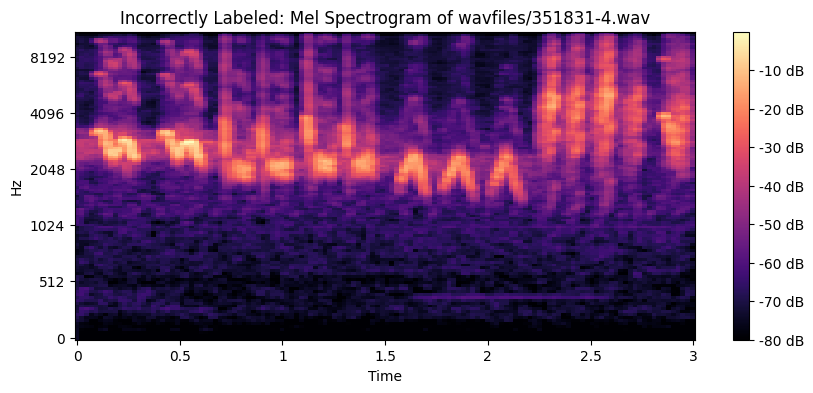

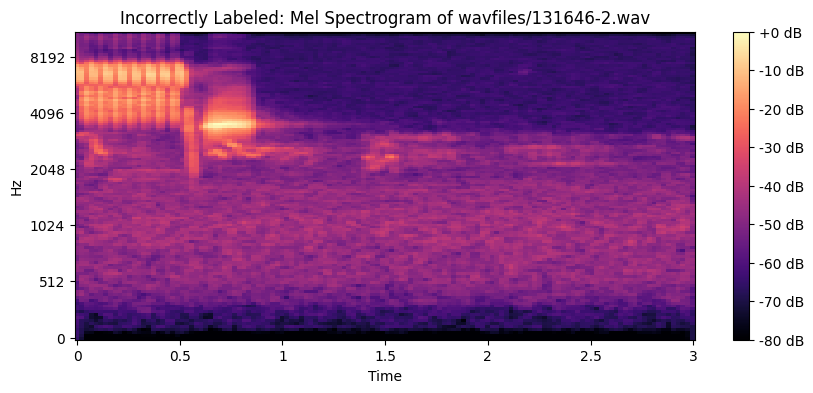

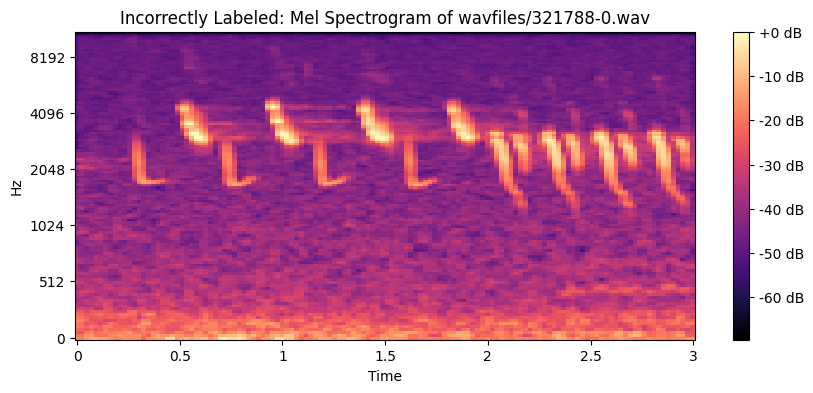

In [ ]:
with zipfile.ZipFile(zip_path, 'r') as z:
    for index in incorrect_indices:
        file_path = files_test[index]
        S_DB, sr = extract_features(file_path, z)
        plot_mel_spectrogram(S_DB, sr, f"Incorrectly Labeled: Mel Spectrogram of {file_path}")

In [ ]:
def detailed_feature_extraction(file_path, zip_file):
    with zip_file.open(file_path) as file:
        y, sr = librosa.load(file, sr=None)
        S = librosa.feature.melspectrogram(y=y, sr=sr, n_mels=128)
        S_DB = librosa.power_to_db(S, ref=np.max)
        mfccs = librosa.feature.mfcc(y=y, sr=sr, n_mfcc=13)
        chroma = librosa.feature.chroma_stft(y=y, sr=sr)
        contrast = librosa.feature.spectral_contrast(y=y, sr=sr)
        return S_DB, mfccs, chroma, contrast, sr

In [ ]:
def plot_features(S_DB, mfccs, chroma, contrast, sr, title):
    fig, axs = plt.subplots(nrows=4, ncols=1, figsize=(10, 16))
    img1 = librosa.display.specshow(S_DB, sr=sr, x_axis='time', y_axis='mel', ax=axs[0])
    axs[0].set(title='Mel Spectrogram')
    fig.colorbar(img1, ax=axs[0], format='%+2.0f dB')

    img2 = librosa.display.specshow(mfccs, sr=sr, x_axis='time', ax=axs[1])
    axs[1].set(title='MFCC')
    fig.colorbar(img2, ax=axs[1])

    img3 = librosa.display.specshow(chroma, x_axis='time', y_axis='chroma', ax=axs[2])
    axs[2].set(title='Chroma')
    fig.colorbar(img3, ax=axs[2])

    img4 = librosa.display.specshow(contrast, x_axis='time', ax=axs[3])
    axs[3].set(title='Spectral Contrast')
    fig.colorbar(img4, ax=axs[3])

    plt.suptitle(title)
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()


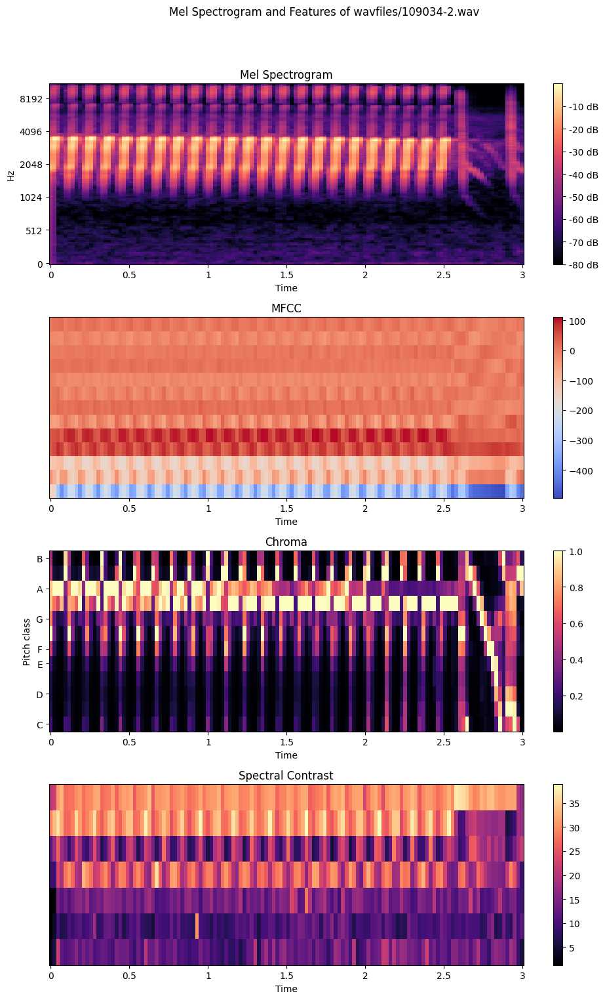

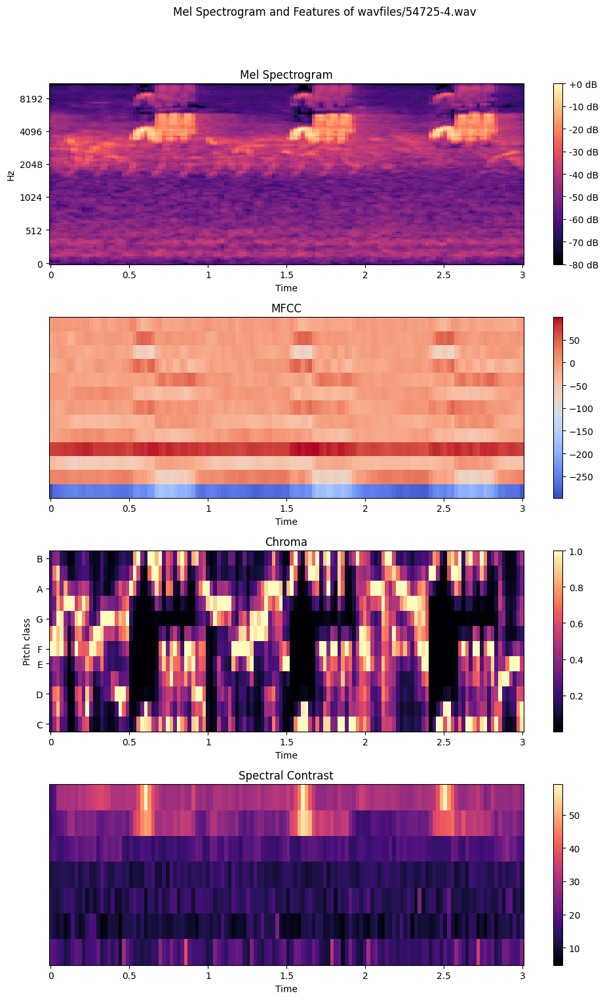

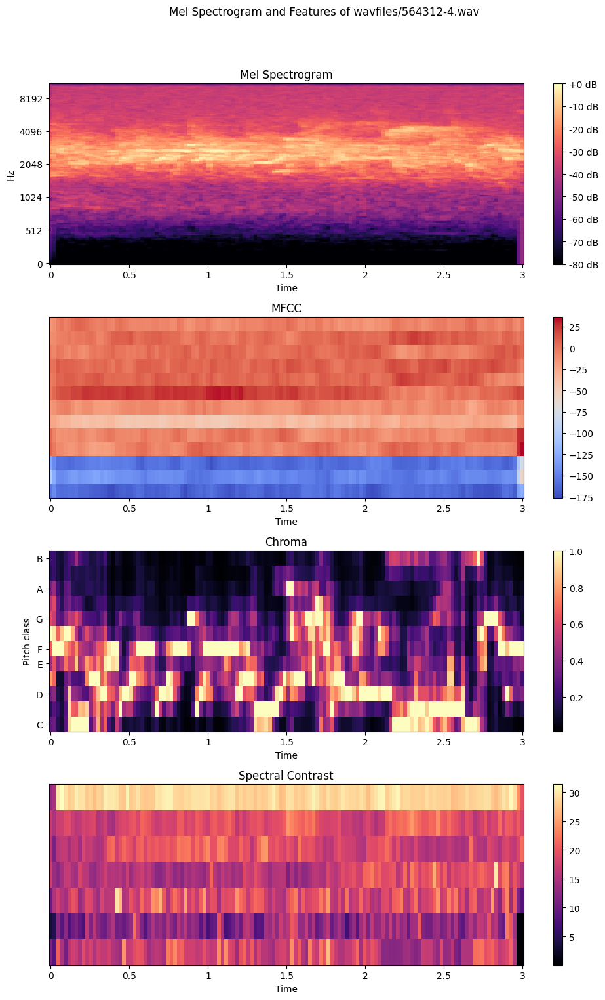

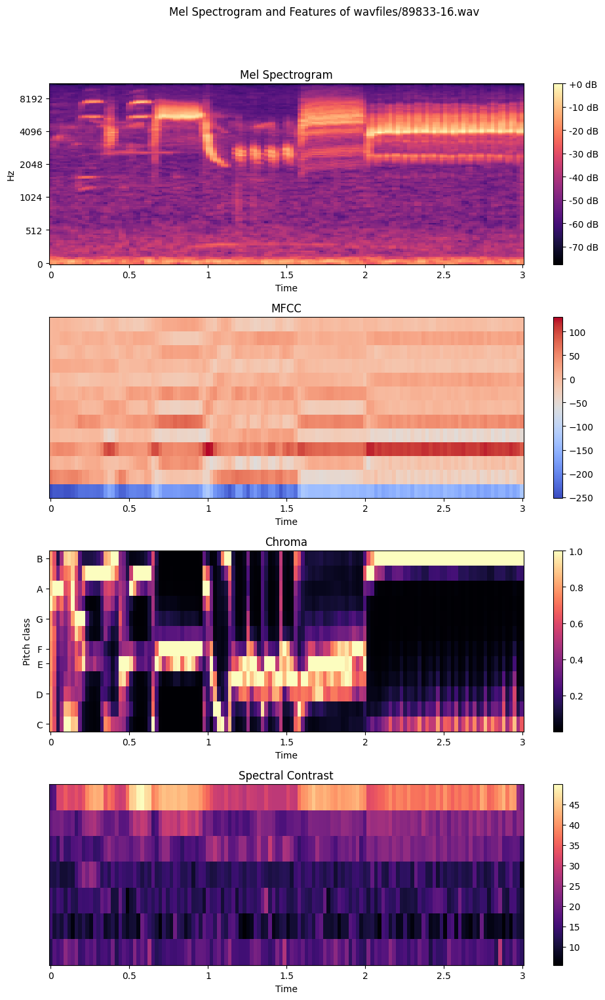

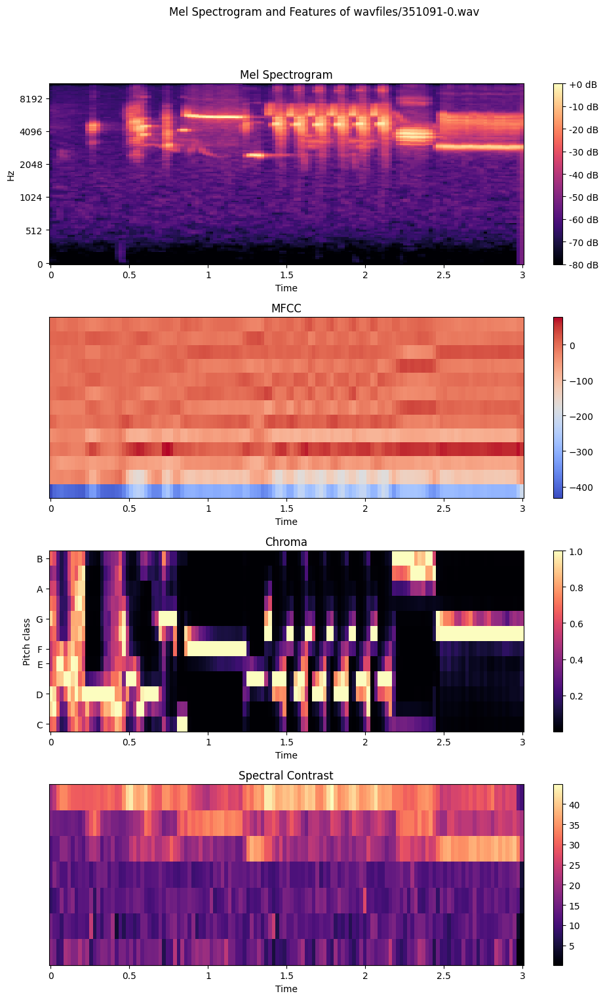

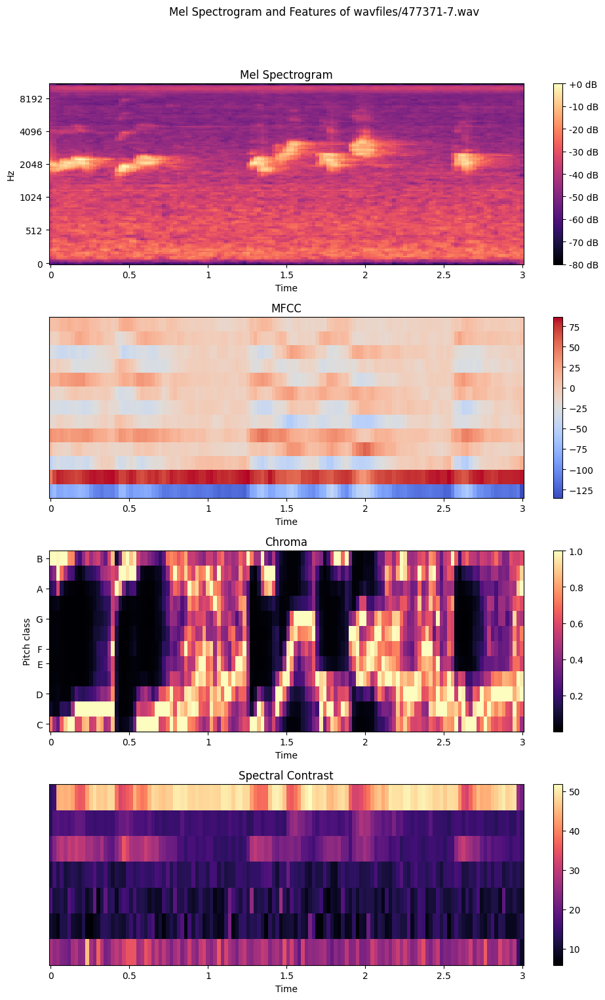

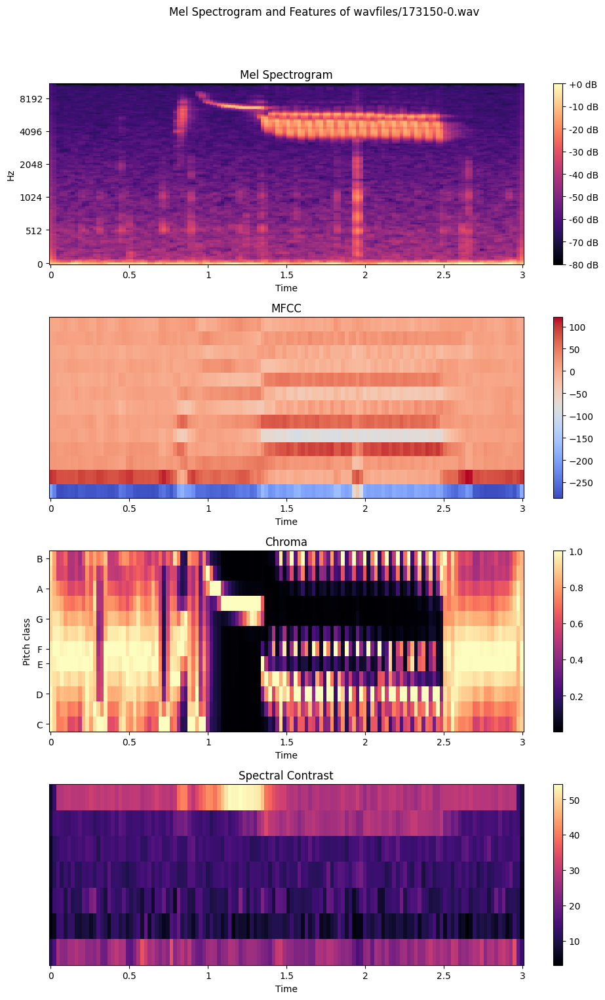

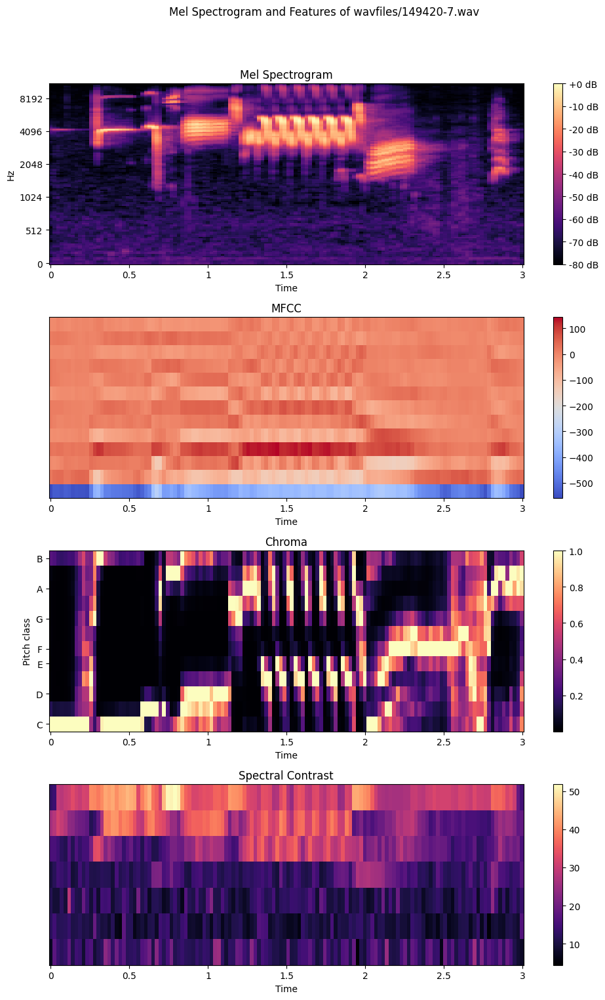

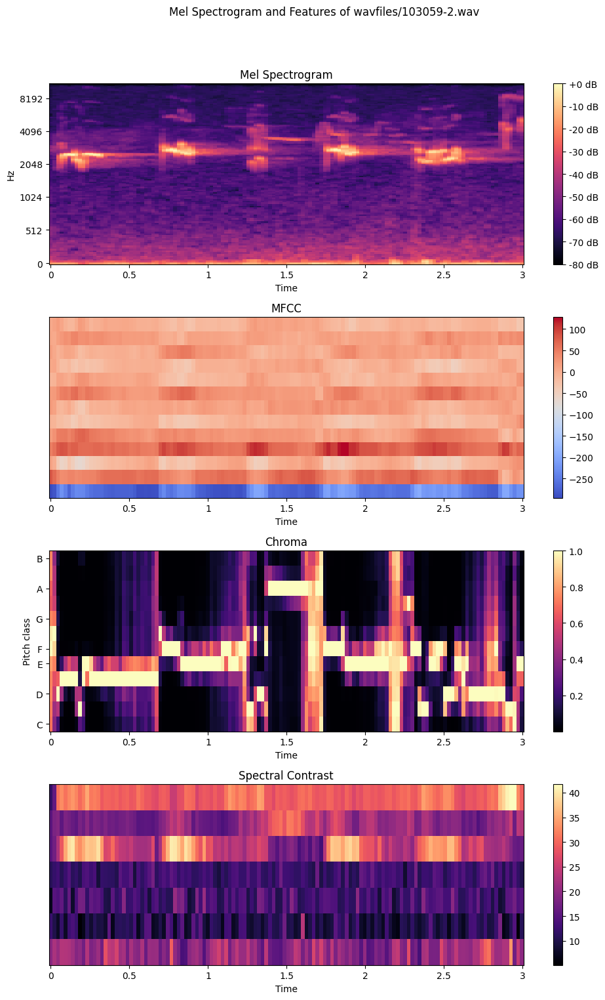

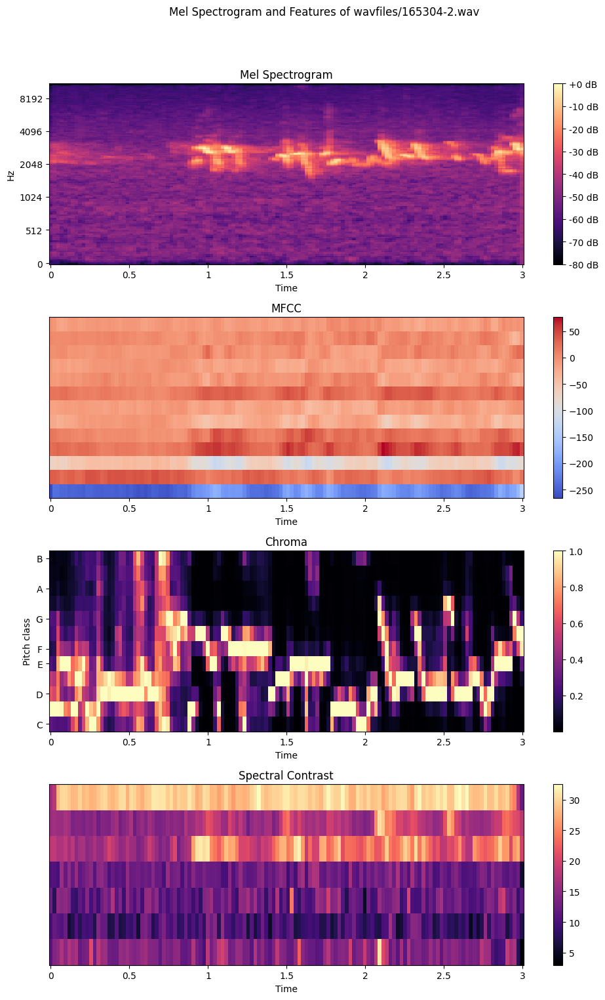

In [ ]:
with zipfile.ZipFile(zip_path, 'r') as z:
    for index in highest_prob_indices:
        file_path = files_test[index]
        S_DB, mfccs, chroma, contrast, sr = detailed_feature_extraction(file_path, z)
        plot_features(S_DB, mfccs, chroma, contrast, sr, f"Mel Spectrogram and Features of {file_path}")

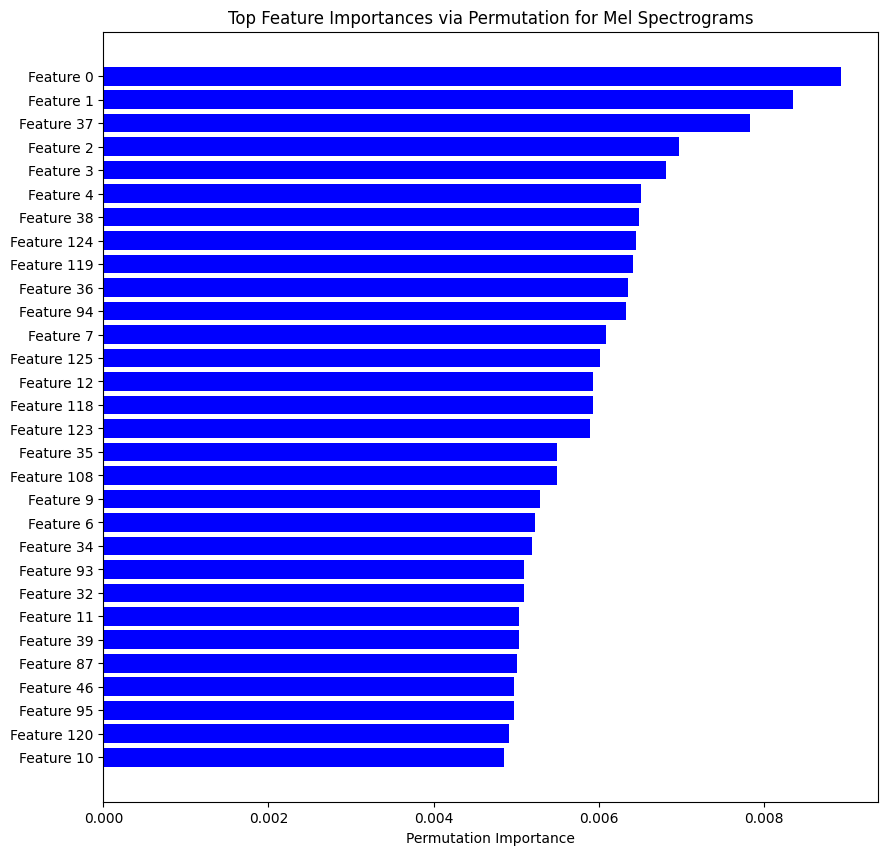

In [ ]:
#Finding importance for Mel using KNN

from sklearn.inspection import permutation_importance

perm_importance = permutation_importance(knn, X_test_mel_scaled, y_test_encoded, n_repeats=30, random_state=42)

importances = perm_importance.importances_mean
sorted_indices = np.argsort(importances)[::-1]  # -1 means in descending order

top_n = 30
top_sorted_indices = sorted_indices[:top_n]

plt.figure(figsize=(10, 10))
plt.barh(range(top_n), importances[top_sorted_indices], color='blue', align='center')
plt.yticks(range(top_n), [f'Feature {i}' for i in top_sorted_indices])
plt.gca().invert_yaxis()  # Invert axis to have the most important feature at the top
plt.xlabel('Permutation Importance')
plt.title('Top Feature Importances via Permutation for Mel Spectrograms')
plt.show()



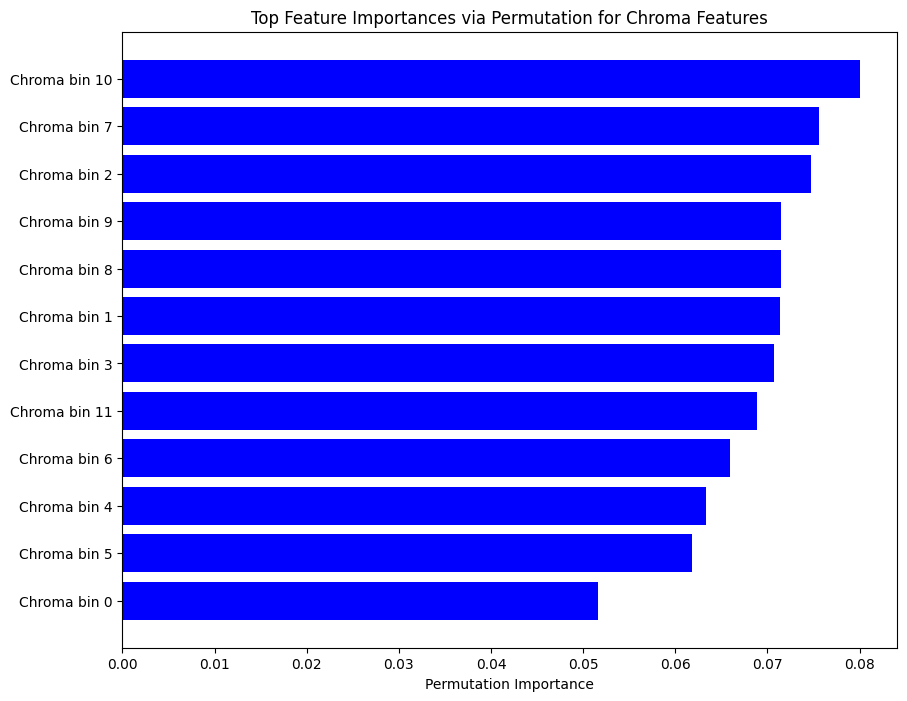

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.inspection import permutation_importance
from sklearn.preprocessing import StandardScaler
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import train_test_split


feature_list_chroma = []
labels = []

with zipfile.ZipFile(zip_path, 'r') as z:
    for index, row in metadata.iterrows():
        file_path = os.path.join('wavfiles', row['filename'])
        if file_path in z.namelist():
            _, _, chroma, _, _ = extract_features(file_path, z)
            feature_list_chroma.append(np.mean(chroma, axis=1)) #1 means across time so flattening across time
            labels.append(row['species'])


X_chroma = np.array(feature_list_chroma)
y_chroma = np.array(labels)


X_train_chroma, X_test_chroma, y_train_chroma, y_test_chroma = train_test_split(X_chroma, y_chroma, test_size=0.2, random_state=42)
scaler = StandardScaler()
X_train_chroma_scaled = scaler.fit_transform(X_train_chroma)
X_test_chroma_scaled = scaler.transform(X_test_chroma)

knn_chroma = KNeighborsClassifier(n_neighbors=5)
knn_chroma.fit(X_train_chroma_scaled, y_train_chroma)


perm_importance_chroma = permutation_importance(knn_chroma, X_test_chroma_scaled, y_test_chroma, n_repeats=10, random_state=42)
importances_chroma = perm_importance_chroma.importances_mean
sorted_indices_chroma = np.argsort(importances_chroma)[::-1]


top_n_chroma = 12 #librosa is by default 12 for chroma
top_sorted_indices_chroma = sorted_indices_chroma[:top_n_chroma]
plt.figure(figsize=(10, 8))
plt.barh(range(top_n_chroma), importances_chroma[top_sorted_indices_chroma], color='blue')
plt.yticks(range(top_n_chroma), [f'Chroma bin {i}' for i in top_sorted_indices_chroma])
plt.gca().invert_yaxis()
plt.xlabel('Permutation Importance')
plt.title('Top Feature Importances via Permutation for Chroma Features')
plt.show()

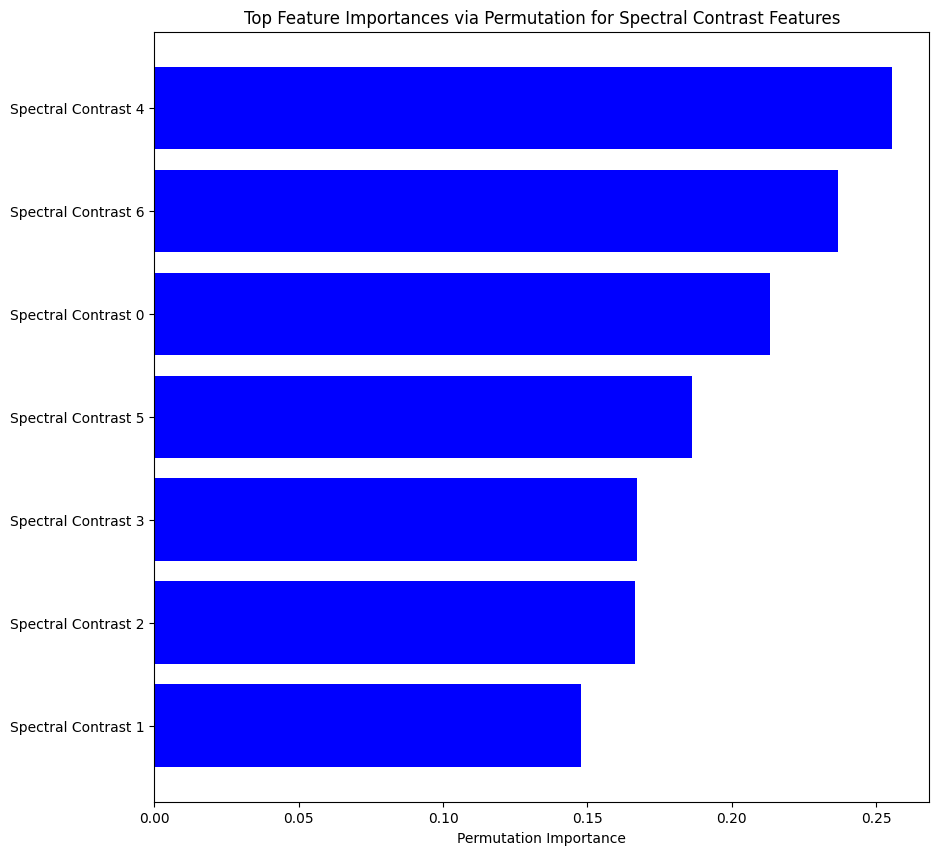

In [ ]:
import matplotlib.pyplot as plt

top_n_contrast = min(30, len(importances_contrast))  # Chooses the smaller between 30 or the actual extracted features (7 in this dataste)

# Now, extracting the top features based on the actual number available
top_sorted_indices_contrast = sorted_indices_contrast[:top_n_contrast]

plt.figure(figsize=(10, 10))
if len(importances_contrast) > 0:  # Check if there are any importances to plot
    plt.barh(range(top_n_contrast), importances_contrast[top_sorted_indices_contrast], color='blue')
    plt.yticks(range(top_n_contrast), [f'Spectral Contrast {i}' for i in top_sorted_indices_contrast])
    plt.gca().invert_yaxis()
    plt.xlabel('Permutation Importance')
    plt.title('Top Feature Importances via Permutation for Spectral Contrast Features')
    plt.show()
else:
    print("No features were found to compute importance. Check your feature extraction process.")
plt.show()

/usr/local/lib/python3.10/dist-packages/librosa/core/pitch.py:101: UserWarning: Trying to estimate tuning from empty frequency set.
  return pitch_tuning(


Evaluating Mel Spectrogram


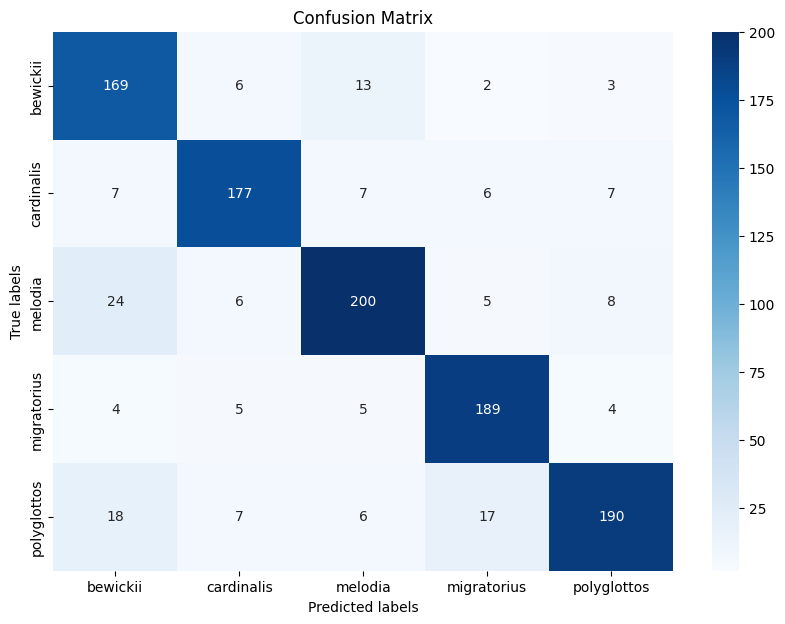

              precision    recall  f1-score   support

           0       0.76      0.88      0.81       193
           1       0.88      0.87      0.87       204
           2       0.87      0.82      0.84       243
           3       0.86      0.91      0.89       207
           4       0.90      0.80      0.84       238

    accuracy                           0.85      1085
   macro avg       0.85      0.86      0.85      1085
weighted avg       0.86      0.85      0.85      1085

Evaluating MFCC


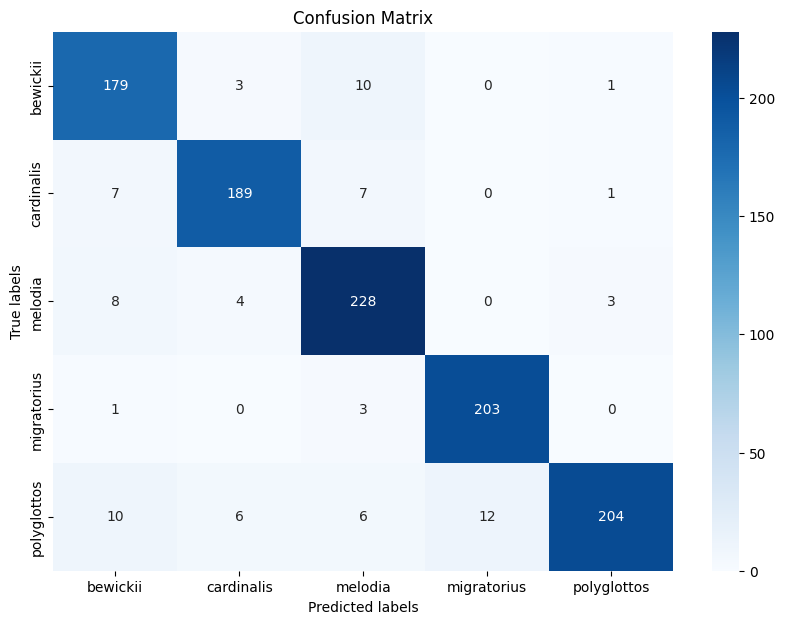

              precision    recall  f1-score   support

           0       0.87      0.93      0.90       193
           1       0.94      0.93      0.93       204
           2       0.90      0.94      0.92       243
           3       0.94      0.98      0.96       207
           4       0.98      0.86      0.91       238

    accuracy                           0.92      1085
   macro avg       0.93      0.93      0.92      1085
weighted avg       0.93      0.92      0.92      1085

Evaluating Chroma


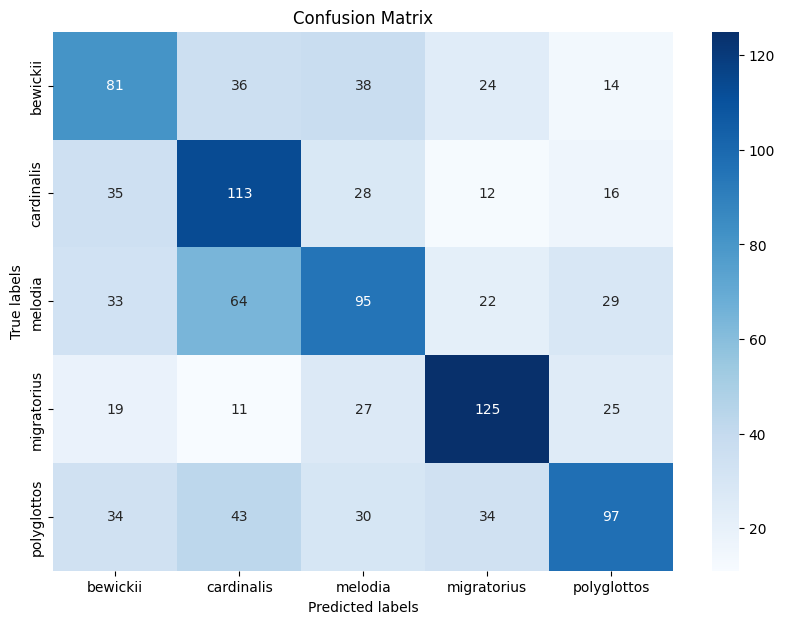

              precision    recall  f1-score   support

           0       0.40      0.42      0.41       193
           1       0.42      0.55      0.48       204
           2       0.44      0.39      0.41       243
           3       0.58      0.60      0.59       207
           4       0.54      0.41      0.46       238

    accuracy                           0.47      1085
   macro avg       0.47      0.48      0.47      1085
weighted avg       0.48      0.47      0.47      1085

Evaluating Spectral Contrast


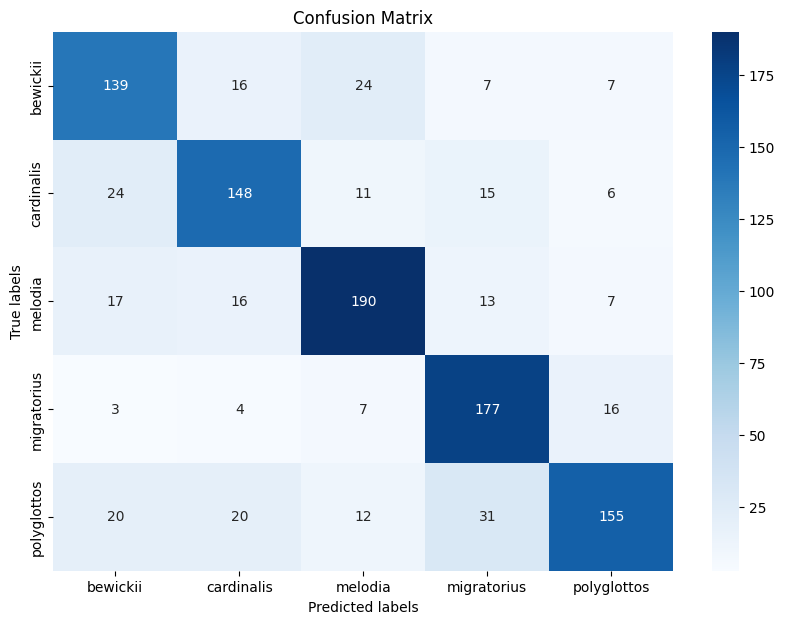

              precision    recall  f1-score   support

           0       0.68      0.72      0.70       193
           1       0.73      0.73      0.73       204
           2       0.78      0.78      0.78       243
           3       0.73      0.86      0.79       207
           4       0.81      0.65      0.72       238

    accuracy                           0.75      1085
   macro avg       0.75      0.75      0.74      1085
weighted avg       0.75      0.75      0.74      1085



In [3]:
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import confusion_matrix, classification_report
import matplotlib.pyplot as plt
import seaborn as sns
import librosa
import pandas as pd
import numpy as np
import zipfile
import os
from sklearn.model_selection import train_test_split

def extract_all_features(file_path, zip_file):
    with zip_file.open(file_path) as file:
        y, sr = librosa.load(file, sr=None)
        # Mel Spectrogram
        mel_spec = librosa.feature.melspectrogram(y=y, sr=sr, n_mels=128)
        mel_spec_db = librosa.power_to_db(mel_spec, ref=np.max)
        # MFCC
        mfccs = librosa.feature.mfcc(y=y, sr=sr, n_mfcc=13)
        # Chroma
        chroma = librosa.feature.chroma_stft(y=y, sr=sr)
        # Spectral Contrast
        contrast = librosa.feature.spectral_contrast(y=y, sr=sr)
        return mel_spec_db, mfccs, chroma, contrast

def train_and_evaluate(features, labels):
    # Standardizing the features
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(features)

    # Label encoding
    label_encoder = LabelEncoder()
    y_encoded = label_encoder.fit_transform(labels)

    # Splitting the data
    X_train, X_test, y_train, y_test = train_test_split(X_scaled, y_encoded, test_size=0.2, random_state=42)

    # KNN Classifier
    knn = KNeighborsClassifier(n_neighbors=5)
    knn.fit(X_train, y_train)

    # Prediction and Evaluation
    y_pred = knn.predict(X_test)
    cm = confusion_matrix(y_test, y_pred)
    plt.figure(figsize=(10, 7))
    sns.heatmap(cm, annot=True, fmt='g', cmap='Blues', xticklabels=label_encoder.classes_, yticklabels=label_encoder.classes_)
    plt.xlabel('Predicted labels')
    plt.ylabel('True labels')
    plt.title('Confusion Matrix')
    plt.show()
    print(classification_report(y_test, y_pred))

# Loading and extracting features
zip_path = '/content/drive/MyDrive/Bird sound classification data/archive (1).zip'
metadata_path = '/content/drive/MyDrive/Bird sound classification data/bird_songs_metadata.csv'
metadata = pd.read_csv(metadata_path)

features_mel = []
features_mfcc = []
features_chroma = []
features_contrast = []
labels = []

with zipfile.ZipFile(zip_path, 'r') as z:
    for index, row in metadata.iterrows():
        file_path = os.path.join('wavfiles', row['filename'])
        if file_path in z.namelist():
            mel_spec_db, mfccs, chroma, contrast = extract_all_features(file_path, z)
            features_mel.append(np.mean(mel_spec_db, axis=1))
            features_mfcc.append(np.mean(mfccs, axis=1))
            features_chroma.append(np.mean(chroma, axis=1))
            features_contrast.append(np.mean(contrast, axis=1))
            labels.append(row['species'])

# Evaluating each feature type
print("Evaluating Mel Spectrogram")
train_and_evaluate(np.array(features_mel), labels)

print("Evaluating MFCC")
train_and_evaluate(np.array(features_mfcc), labels)

print("Evaluating Chroma")
train_and_evaluate(np.array(features_chroma), labels)

print("Evaluating Spectral Contrast")
train_and_evaluate(np.array(features_contrast), labels)
